# Deep Convolutional Adaptive Discriminator Augmentation GANs (DCADA GANs) with CIFAR10
### Generating new images using GANs using the CIFAR10 dataset
Author: Andric Ang

# Background Information
The dataset we will be working with is the cifar10 dataset. It consists of 10 classes, and 60000 total images. With each class containing 6000 32x32x3 colour images.
- 0 = airplane										
- 1 = automobile										
- 2 = bird										
- 3 = cat										
- 4 = deer										
- 5 = dog										
- 6 = frog										
- 7 = horse										
- 8 = ship										
- 9 = truck

Computer algorithms for recognizing objects in photos often learn by example. CIFAR-10 is a set of images that can be used to teach a computer how to recognize objects. Since the images in CIFAR-10 are low-resolution (32x32), this dataset can allow researchers to quickly try different algorithms to see what works. Various kinds of convolutional neural networks tend to be the best at recognizing the images in CIFAR-10. CIFAR-10 is a labeled subset of the 80 million tiny images dataset.

----
# Problem
We are tasked to use Generative Adversarial Networks(GANs) to create 1000 small colour images. 

Generative Adversarial Networks(GANS) is a framework for estimating generative models via an adversarial process, in which we simultaneously train two models: a generative model G
that captures the data distribution, and a discriminative model D that estimates
the probability that a sample came from the training data rather than G. The training procedure for G is to maximize the probability of D making a mistake. This
framework corresponds to a minimax two-player game. ([Generative Adversarial Nets](https://arxiv.org/pdf/1406.2661.**pdf**))

GANs however has a reputation of being very computationally expensive to train, thus train times for SOTA GANs are not feasible on my machine.

----
# Solution
The specific type of GANs I would be using would be Deep Convlutional Adaptive Discriminator Augmentation GANs. I chose to use this type of GANs as Deep Convolutional GANs are not that computationally expensive to train, unlike SOTA GANs and Wesserstein GANs. And also chose to use Adaptive Discriminator Augmentation(ADA) on the DC GANs as the authors of [StyleGAN2-ADA](https://arxiv.org/pdf/2006.06676.pdf) show that discriminator overfitting can be an issue in GANs, especially when only low amounts of training data is available and proposed ADA as a means to mitigate this issue. 

Since we only have 60000 images which is considered a smaller datasize I chose to implement ADA.

I will also be trying out different ways of image augmentation on the dataset before inputting it into the model. Such as PIL and using an Auto Encoder.
- For the auto encoder, I will be using it to remove low quality images from the dataset that the generator might have difficulty generating. As if we input better quality images into the GANs, it will generate better quality images as well.
- I PIL the dataset as from my last project doing CNN on cifar10, I found out that the model can interpret the images better when its sharpened, since the generator and discriminator would also be using convolutional layers to learn the features of the real dataset(similar to CNN) I think using PIL will improve the quality of the images produced. Therefore, I will be implementing PIL into my image preprocessing.

After the image preprocessing, I will be splitting up the images and grouping them by classes. As if you give the model all the images, it will learn the features of all the classes and the images it will generate will be a combination of all the features from all classes. Thus, I will be training 10 seperate models as there are 10 seperate classes.

As my models are training, I will be scoring the model every epoch using KID as a metric. I will be using the KID score to determine which epoch of the model produces the best image as it will automatically save the model with the best KID scorel.

I will then compare all the classes generated images and run them through a CNN classifier I made for my last assignment and use the images that got predicited correctly as my final generated images. This is to ensure that only the good generated images will make it through to the final dataset.

----

# Notebook Initialization

### Importing Modules

In [1]:
import glob
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly import tools
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import os
from tensorflow.keras import layers
import time
import tensorflow as tf
import pandas as pd
from keras.datasets import cifar10
from keras.models import Sequential, Model
from keras.layers import Input, Dense, LeakyReLU, BatchNormalization, ReLU, Flatten, Dropout
from keras.layers import Conv2D, Conv2DTranspose, Reshape, Flatten, GaussianNoise
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
from keras.utils import np_utils
from keras import initializers
from keras import backend as K
from numpy import zeros, ones
from numpy.random import rand, randint, randn
from matplotlib import pyplot
from keras.utils.vis_utils import plot_model
from keras.metrics import Mean, BinaryAccuracy
from keras.models import clone_model, load_model
from tensorflow.keras.models import load_model
import keras as keras
import tensorflow_datasets as tfds
from PIL import ImageEnhance, Image
import tensorflow_addons as tfa
# from tensorflow_addons.layers import SpectralNormalization
from IPython import display
from sklearn.model_selection import train_test_split
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from skimage.transform import resize
from scipy.linalg import sqrtm
from numpy import iscomplexobj
from numpy import cov
from numpy import trace
import imageio
import base64
import mimetypes
import os
import pathlib
import textwrap
import IPython.display
import pickle

tf.config.run_functions_eagerly(True)

### Setting a fixed seed
I will be setting a fixed random seed as I want consistency between multiple runs when I am experimenting on the model.

In [2]:
tf.random.set_seed(12)
np.random.seed(12)

### Model Settings

In [3]:
# data
num_epochs = 3000  # train for 400 epochs for good results
image_size = 32
# resolution of Kernel Inception Distance measurement, see related section
kid_image_size = 75
padding = 0.25
dataset_name = "cifar10"

# adaptive discriminator augmentation
max_translation = 0.125
max_rotation = 0.125
max_zoom = 0.25
target_accuracy = 0.85
integration_steps = 1000

# architecture
noise_size = 64
depth = 3
width = 256
leaky_relu_slope = 0.2
dropout_rate = 0.4
BN_MIMENTUM = 0.1
BN_EPSILON  = 0.00002

# optimization
batch_size = 256
learning_rate = 2e-4
beta_1 = 0.5  # not using the default value of 0.9 is important
ema = 0.99

## Functions

### Plotting Function DCADA

In [4]:
def create_trace(x, y, ylabel, color):
    trace = go.Scatter(
        x=x, y=y, name=ylabel, marker=dict(color=color), mode="markers+lines", text=x
    )
    return trace

def plot_accuracy_and_loss(model):
    hist = model.history
    g_loss = hist["g_loss"]
    d_loss = hist["d_loss"]
    real_acc = hist["real_acc"]
    gen_acc = hist["gen_acc"]
    aug_p = hist["aug_p"]
    kid = hist['kid']
    epochs = list(range(1, len(g_loss) + 1))

    trace_ta = create_trace(epochs, g_loss, "g_loss", "Green")
    trace_va = create_trace(epochs, d_loss, "d_loss", "Red")
    trace_tl = create_trace(epochs, real_acc, "real_acc", "Blue")
    trace_vl = create_trace(epochs, gen_acc, "gen_acc", "Magenta")
    trace_aug = create_trace(epochs, aug_p, "aug_p", "Orange")
    trace_kid = create_trace(epochs, kid, "aug_p", "Brown")

    fig = tools.make_subplots(
        rows=4,
        cols=1,
        subplot_titles=(
            "generator and discriminator loss",
            "real and generator accuracy",
            "Augmentation Probability",
            "KID Metric"
        ),
    )
    fig.append_trace(trace_ta, 1, 1)
    fig.append_trace(trace_va, 1, 1)
    fig.append_trace(trace_tl, 2, 1)
    fig.append_trace(trace_vl, 2, 1)
    fig.append_trace(trace_aug, 3, 1)
    fig.append_trace(trace_kid, 4, 1)
    fig["layout"]["xaxis"].update(title="Epoch")
    fig["layout"]["xaxis2"].update(title="Epoch")
    fig["layout"]["xaxis3"].update(title="Epoch")
    fig["layout"]["xaxis4"].update(title="Epoch")
    fig["layout"]["yaxis"].update(title="Loss", range=[0, 1])
    fig["layout"]["yaxis2"].update(title="Accuracy", range=[0, 1])
    fig["layout"]["yaxis3"].update(title="Probability", range=[0, 1])
    fig["layout"]["yaxis4"].update(title="KID", range=[0, 1])
    fig.update_layout(height=800, width=2000)

    iplot(fig, filename="accuracy-loss")

### Plotting Function DC

In [5]:
def plot_accuracy_and_loss2(model):
    hist = model.history
    g_loss = hist["g_loss"]
    d_loss = hist["d_loss"]
    real_acc = hist["real_acc"]
    gen_acc = hist["gen_acc"]
    kid = hist['kid']
    epochs = list(range(1, len(g_loss) + 1))

    trace_ta = create_trace(epochs, g_loss, "g_loss", "Green")
    trace_va = create_trace(epochs, d_loss, "d_loss", "Red")
    trace_tl = create_trace(epochs, real_acc, "real_acc", "Blue")
    trace_vl = create_trace(epochs, gen_acc, "gen_acc", "Magenta")
    trace_kid = create_trace(epochs, kid, "aug_p", "Brown")

    fig = tools.make_subplots(
        rows=3,
        cols=1,
        subplot_titles=(
            "generator and discriminator loss",
            "real and generator accuracy",
            "KID Metric"
        ),
    )
    fig.append_trace(trace_ta, 1, 1)
    fig.append_trace(trace_va, 1, 1)
    fig.append_trace(trace_tl, 2, 1)
    fig.append_trace(trace_vl, 2, 1)
    fig.append_trace(trace_kid, 3, 1)
    fig["layout"]["xaxis"].update(title="Epoch")
    fig["layout"]["xaxis2"].update(title="Epoch")
    fig["layout"]["xaxis3"].update(title="Epoch")
    fig["layout"]["yaxis"].update(title="Loss", range=[0, 1])
    fig["layout"]["yaxis2"].update(title="Accuracy", range=[0, 1])
    fig["layout"]["yaxis3"].update(title="KID", range=[0, 1])
    fig.update_layout(height=800, width=2000)

    iplot(fig, filename="accuracy-loss")

### Save Model Function

In [6]:
def saveModels(model,name):
    model.ema_generator.save(f'./Model History/{name}/emaGen')
    model.generator.save(f'./Model History/{name}/gen')

### Loading in GIFs

In [7]:
def loadGIFS(classname):
    anim_file = f'./Generated Images/{classname}/{classname}.gif'
    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob(f'./Generated Images/{classname}/epoch*.png')
        filenames = sorted(filenames)
        for filename in filenames:
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

### Embedding GIFs Function

In [8]:
def embed_data(mime: str, data: bytes) -> IPython.display.HTML:
  """Embeds data as an html tag with a data-url."""
  b64 = base64.b64encode(data).decode()
  if mime.startswith('image'):
    print(1)
    tag = f'<img src="data:{mime};base64,{b64}" height="500" width="1000" />'
  elif mime.startswith('video'):
    print('he')
    tag = textwrap.dedent(f"""
        <video width="640" height="480" controls>
          <source src="data:{mime};base64,{b64}" type="video/mp4">
          Your browser does not support the video tag.
        </video>
        """)
  else:
    raise ValueError('Images and Video only.')
  return IPython.display.HTML(tag)


def embed_file(path: os.PathLike) -> IPython.display.HTML:
  """Embeds a file in the notebook as an html tag with a data-url."""
  path = pathlib.Path(path)
  mime, unused_encoding = mimetypes.guess_type(str(path))
  data = path.read_bytes()

  return embed_data(mime, data)

In [9]:
def round_to_int(float_value):
    return tf.cast(tf.math.round(float_value), dtype=tf.int32)

def sharpen(img):
  enhancer = ImageEnhance.Sharpness(img)
  new_img = enhancer.enhance(3.3) #1.5
  return new_img

# Loading in the dataset
I decided to concatenate the train and test set together after loading in the data as from my research GANs is sensitive to data size. Thus having a larger datasize to train the GANs with will produce better results.

In [10]:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()
print(f'Training image: {X_train.shape}, Training labels: {y_train.shape}')
print(f'Testing image: {X_test.shape}, Testing labels: {y_test.shape}')

Training image: (50000, 32, 32, 3), Training labels: (50000, 1)
Testing image: (10000, 32, 32, 3), Testing labels: (10000, 1)


In [11]:
X_full = np.concatenate([X_train, X_test])
y_full = np.concatenate([y_train, y_test])
print(f'Images: {X_full.shape}, Labels: {y_full.shape}')

Images: (60000, 32, 32, 3), Labels: (60000, 1)


In [12]:
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

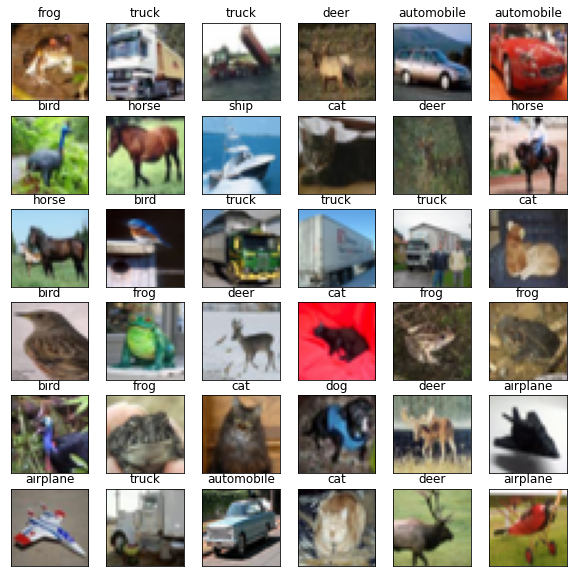

In [30]:
plt.figure(figsize=(10, 10))
for i in range(36):
    plt.subplot(6, 6, i + 1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(X_full[i].reshape((32,32,3)))
    label_index = int(y_full[i])
    plt.title(class_names[label_index])
plt.show()

# AutoEncoder with SSIM scoring metric

I will be using an AutoEncoder with SSIM to remove 'bad' images from the initial dataset as allowing the model to learn the features of bad images will make it learn to generate those bad features as well, which will negatively affect the generated images as they might contain the bad features and thus reduce the quality of the generated image.

My idea of using the AutoEncoder and then scoring with the SSIM comes from the fact that the AutoEncoder downscales the image then tries to rebuild it using Conv2DTranspose which is a similar process when we train the generator of GANs to build similar images using Conv2DTranspose later on. Therefore, my idea is to run my images through this AutoEncoder where all the images will be downscaled by the Conv2D layers then scaled back to normal using Conv2DTranspose layer. I will then take the auto encoded pictures and calculate its Structural Similarity with its non-AutoEncoded picture. I will then remove any images below a 0.95 SSIM Score, this are images that I deem have poor Structural Similarity with its non-AutoEncoded image after being put through a simple Conv2DTranspose.

If these images have poor SSIM score only after one Conv2DTranspose layer, that means that the image already do not look similar after one Conv2DTranspose. So when training the generator using one of these images, it will perform poorly as the generator has the same process of Conv2DTranspose but with 4 layers. Which will make the generated image look even less structurely similar to the images I used to train the model. Thus producing a bad output, so I will be using this method to reduce the number of 'bad quality' images from the images I use to train the GANs model.

<img src='autoencoder.png'>

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 32)        896       
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 32)        9248      
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 32)        9248      
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 32)       128       
 hNormalization)                                                 
                                                                 
 conv2d_transpose (Conv2DTra  (None, 32, 32, 32)       9

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/20
196/196 [==============================] - 9s 33ms/step - loss: 0.0058 - Accuracy: 0.6961 - val_loss: 0.0280 - val_Accuracy: 0.5968
Epoch 2/20
196/196 [==============================] - 6s 32ms/step - loss: 0.0011 - Accuracy: 0.8080 - val_loss: 0.0064 - val_Accuracy: 0.7577
Epoch 3/20
196/196 [==============================] - 6s 32ms/step - loss: 7.6431e-04 - Accuracy: 0.8308 - val_loss: 9.1276e-04 - val_Accuracy: 0.8156
Epoch 4/20
196/196 [==============================] - 6s 32ms/step - loss: 6.0594e-04 - Accuracy: 0.8458 - val_loss: 5.6265e-04 - val_Accuracy: 0.8360
Epoch 5/20
196/196 [==============================] - 6s 32ms/step - loss: 4.8754e-04 - Accuracy: 0.8555 - val_loss: 5.2171e-04 - val_Accuracy: 0.8202
Epoch 6/20
196/196 [==============================] - 6s 32ms/step - loss: 4.5692e-04 - Accuracy: 0.8597 - val_loss: 4.1185e-04 - val_Accuracy: 0.8680
Epoch 7/20
196/196 [==============================] - 6s 32ms/step - loss: 3.8368e-04 - Accuracy: 0.8682 - val

C:\Users\Andric\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



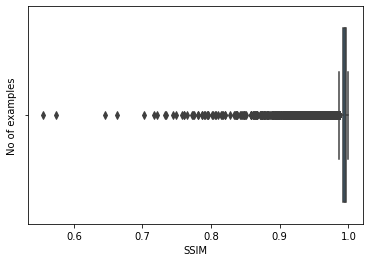

434


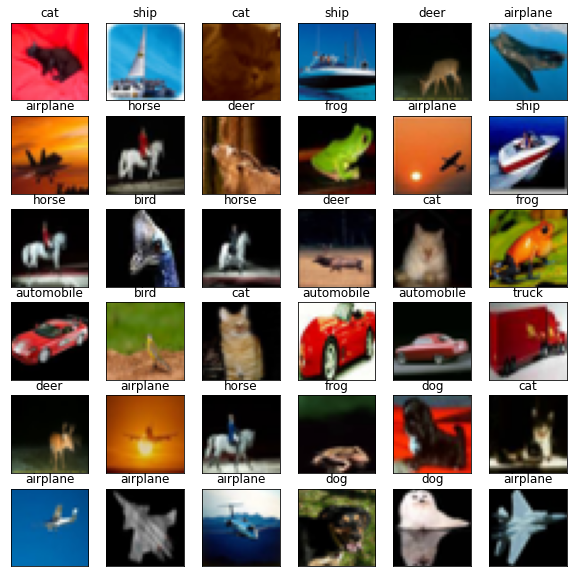

(59566, 32, 32, 3)
(59566, 1)


In [15]:
### Removing Bad Samples
X_train2 = X_train.astype('float32')/255
X_test2 = X_test.astype('float32')/255
X_full2 = X_full.astype('float32')/255

autoencoder = Sequential()
# Encoder
autoencoder.add(Conv2D(32, (3, 3), activation="relu", padding="same",input_shape = (32,32,3)))
autoencoder.add(BatchNormalization())
autoencoder.add(Conv2D(32, kernel_size=3, strides=2, padding='same', activation='relu'))

autoencoder.add(Conv2D(32, (3, 3), activation="relu", padding="same"))
autoencoder.add(BatchNormalization())
# Decoder
autoencoder.add(Conv2DTranspose(32, (3, 3), strides=2, activation="relu", padding="same"))
autoencoder.add(Conv2D(3, (1,1), activation="sigmoid", padding="same"))

# Autoencoder
autoencoder.compile(optimizer="adam", loss="mean_squared_error",metrics = ['Accuracy'])
autoencoder.summary()

autoencoder.fit(X_train2, X_train2, 
          epochs=20,
          batch_size=batch_size,
          validation_data=(X_test2, X_test2),
          shuffle=True)

reconstructed = autoencoder.predict(X_full2)

print(reconstructed.max())
print(reconstructed.min())

ssim_score = []
for i in range(len(X_full2)):
  ssim_score.append(tf.image.ssim(reconstructed[i], X_full2[i], max_val=1))
ssim_score = np.array(ssim_score)

sns.boxplot(ssim_score)
plt.xlabel("SSIM")
plt.ylabel("No of examples")
plt.show()

ssim_df = pd.DataFrame(ssim_score)
bad_imgs_index = ssim_df[ssim_df.loc[:,0] < 0.95].index
print(bad_imgs_index.size) 

plt.figure(figsize=(10, 10))
for i in range(36):
    plt.subplot(6, 6, i + 1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(X_full2[bad_imgs_index[i]])
    label_index = int(y_full[bad_imgs_index[i]])
    plt.title(class_names[label_index])
plt.show()

X_reduced = np.delete(X_full, bad_imgs_index,axis = 0)
X_reduced.reshape(X_full.shape[0] - bad_imgs_index.shape[0], 32,32,3)
y_reduced = np.delete(y_full, bad_imgs_index,axis = 0)

print(X_reduced.shape)
print(y_reduced.shape)

This shows the distribution of the amount of images that have been removed by the Autoencoder with SSIM scoring metric above. From this bar graph we can see that the class with the most removed images is airplane with 82. Also if the class with the most removed images is only 82, the overall distribution of data accross all 10 classes after this processs is still relatively uniform. 

<BarContainer object of 10 artists>

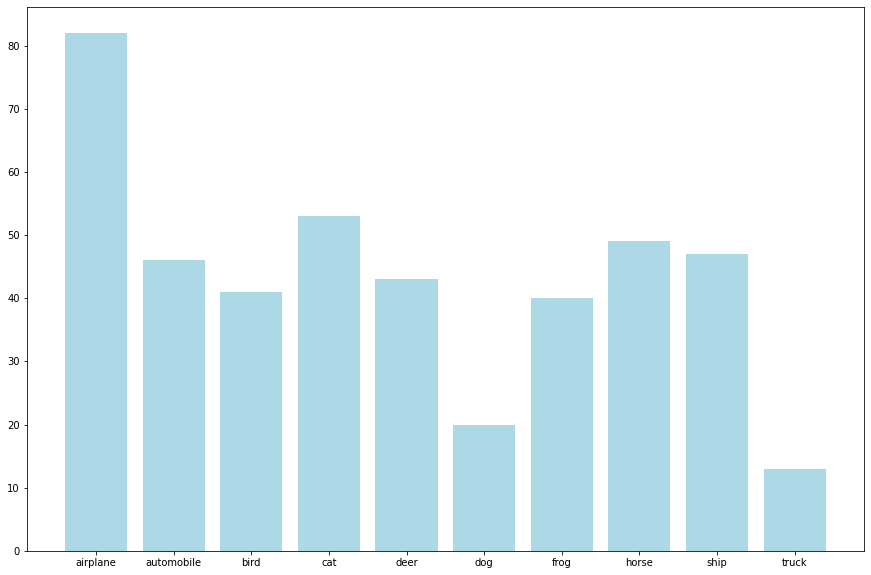

In [16]:
(uni, counts) = np.unique(y_full[bad_imgs_index],  return_counts=True)
plt.figure(figsize = (15,10))
plt.bar(height = counts, x= class_names, color='LightBlue')

# Splitting Up The Dataset
I will be splitting up the dataset into 10 sets, one for each class. I will also be applying python PILLOW augmentation to the images as I found that it improves performance. I will be using the sharpen filter as I found that the output from the gans after inputting augmented images with the sharpen filter is the best.

In [17]:
X_pil = []

for i in range(len(X_reduced)):
    img = Image.fromarray(np.uint8(X_reduced[i]))
    new_img = sharpen(img)
    new_img = np.array(new_img)/255
    X_pil.append(new_img)

X_pil = np.array(X_pil)

Here Im splitting the dataset

In [18]:
split_dataset = []

for i in range(10):
    idx = (y_reduced == i).reshape(X_pil.shape[0])
    split_dataset.append(X_pil[idx])

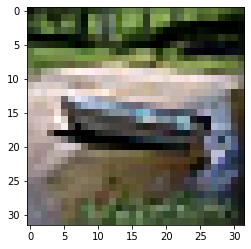

In [19]:
plt.imshow(split_dataset[8][1342])

In [20]:
split_dataset[1].shape

(5954, 32, 32, 3)

# DC GANs
I will be using a regular DC GANs as my baseline model, and then compare it to DCADA GANs later on so we can see the improvements ADA brings.

For my baseline model I will be training with the full CIFAR10 set of images, as this is the first time I was exposed to GANs and also that I read that GANs are sensitive to the amount of data given to them, thus I decided that I would give it as much data as I can to train it. However, I will later on find out why that is a bad idea which I will explain later.

Here is a regular generator and discriminator for DC GANs. This are the 2 models that makes up the GANs architecture of having 2 adversarial networks trying to beat each other. The generator model here is incharge of generating images from random uniform noise as input. It uses Conv2DTranspose layers to transform this noise into a meaningful output. Experiments suggest that the distribution of the noise doesn't matter much, so we can choose something that's easy to sample from, like a uniform distribution. The dimensionality of the noise we are inputting is also smaller than the dimensions of the output of the generator for convenience sake.

The Discriminator on the other hand is used to train the generator. It is a CNN network that is fed real images to train the network. It is then used to classify the output from the generator, the discriminator would classify the generated images as either real or fake. If the discriminator classifies the images from the generator as fake, the generator loss will penalise the generator for producing an image that the discriminator thinks its fake. This would help point the generator in the right direction to make the images more real so that it can fool the discriminator.

The specific way that the generator learns is by calculating the loss from the discriminator classification, then back propagating through both the discriminator and the generator to obtain gradients, and use the gradients to change only the generators weights.

## Functions

### Generator and Discriminator Functions
##### Generator
The generator takes in a one dimensional 64 input of random uniform noise and outputs a 32x32x3 image.
- It starts with an input layer that takes in one dimensional 64 datapoints of random uniform noise
- Next, it gets sent to a dense layer where it takes in 64 input and outputs 2048. This is done so that there will be enough datapoints to reshape the data into a 4x4x128 which will be a low quality representation of the image. We also want a high feature map (128) as each of them will have different learnt features that will be collasped in the output layer into a final image. This is done as with more feature maps, the model will be able to pick up on more features to generate and thus produce more detailed images when collasped and outputted. 
- Next is an activation layer using ReLU. ReLU is recommended to be used on the generator and not the discriminator, and is used to address the vanishing gradient problem. This activation function turns all negative numbers to 0 and does nothing to positive numbers.
- Next I will reshape the 2048 datapoints into a 4x4x128 output shape. This is integral to the architecture of the generator in GAN models where we start to upsample the low resolution images into a higher resolution. There are 2 ways to achieve upsampling, UpSampling2D layer and also the Conv2D layer. However, the latest approach to the problem of upsampling the images is to use Conv2DTranspose, which is a combination of the 2 layers I mentioned just now. Therefore, I will be using Conv2DTranspose as my method of upsampling
- Next, I send my 4x4x128 image into a Conv2DTranspose layer to upsample my image. I will be using a kernel size of 4 and strides of 2 with padding=same. Kernel size of 4 dictates that my 2D convolution window will be a 4x4 shape. A convolution window is what the layer uses to examine the image, with a 4x4 window the layer will be examining the image 4x4 pixels at a time. I set it to 4 as its a way of avoiding the checkboard effect that can happen with upsampling if the kernel size is not double the value of the stride, so if my stride is 2 my kernal size would be 4. With stride of 2, I will be essentially doubling the size of my output which is what I want as I am trying to increase the resolution of my image. And I set padding to same, so that my image will not be downscaled, so that the stride=2 will double the image resolution properly. So the output will now be 8x8x128
- Next I will send the data through an activation layer of LeakyReLU
- Then I send my 8x8x128 into a Conv2DTraspose layer to double the size and upsample the image to a 16x16x128
- Into another activation layer of ReLU
- Finally into another Conv2DTranspose layer to double the size and upsample to the target output size of 32x32x3. I set the number of neurons on this final layer to 3 as that is the number of feature maps the original CIFAR10 images have. I also use the sigmoid activation function so that the output values are all in the desired range of 0-1

The optimizer I will be using for my generator would be the Adam optimizer with a learning rate of 0.0002 as it has been shown to be the best optimizer to be used on GANs

<img src='dcgan_gen.png'>

##### Discriminator
While my discriminator consists of 2 layers of Conv2D -> LeakyReLU -> Dropout as the architechture.
- I used LeakyReLU as my activation layer it has been shown to be the best practice for discriminator models in GANs. Using ReLU in the discriminator might cause the network to be stuck in a popular state called the dying state, using LeakyReLU prevents this as it allows some negative numbers to pass through. The whole idea of GANs will not work if the Generator is unable to learn from the discriminator if the discriminator network is stuck in a dying state situation. Therefore, LeakyReLU is used.
- The Conv2D layers I used have kernel sizes of 3 and strides of 2 with padding=same. This translate to the output after the Conv2D layer would be half. Since I have 2 of these layers in my discriminator, it means that my input data shape would be divided by 2 twice. So the input shape going into the Flatten layer would be 8x8x64. This method is used so that I do not need pooling layers to downsample my images, as I can use the Conv2D layers to achieve a similar effect. My Conv2D layers also have 64 neurons, therefore the feature maps of the images would be increased to 64 layers. This discriminator has the same architecture as a CNN model for good reason. Both architectures are used for Image Classification, in the case for the discriminator it is supposed to classify if the image is real or fake.
- The Flatten layer is used to flatten the image shape into one dimension, so from 8x8x64 to 4096
- For the output of model I will be using a dense layer with one neuron. But I will not be applying a activation function, so the output is linear. This is done as its more numerically stable to compute gradients inputting the logits into the loss function later with the from_logits=True statement.

The optimizer I will be using for my discriminator would be the Adam optimizer with a learning rate of 0.0002 as it has been shown to be the best optimizer to be used on GANs

<img src='dcgan_discriminator.png'>

In [26]:
def get_generator():
    noise_input = keras.Input(shape=(noise_size,))
    x = layers.Dense(4 * 4 * 128, use_bias=False)(noise_input)
    x = layers.ReLU(x)
    x = layers.Reshape(target_shape=(4, 4, 128))(x)
    x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same")(x)
    x = layers.ReLU(x)
    x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same")(x)
    x = layers.ReLU(x)
    image_output = layers.Conv2DTranspose(3, kernel_size=4, strides=2, padding="same", activation="sigmoid",)(x)
    return keras.Model(noise_input, image_output, name="generator")

def get_discriminator():
    image_input = Input(shape=(image_size, image_size, 3))
    x = layers.Conv2D(64, kernel_size=3, strides=2, padding='same')(image_input)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.4)(x)
    x = layers.Conv2D(64, kernel_size=3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.4)(x)
    x = layers.Flatten()(x)
    output_score = layers.Dense(1)(x)
    return keras.Model(image_input, output_score, name="generator")

### Kernel Inception Distance
I will be explaining why I will be using Kernal Inception Distance as my main evaluation metric in greater detail later on.

For now, all we need to know is that the KID score is calculated by comparing a real image to a generated image to see how good the generated image is compared to a real image. The lower the KID score, the better the generated image will be compared to the real image. A higher KID score indicates that the generated image is not good compared to the real image.

In [14]:
class KID(keras.metrics.Metric):
    def __init__(self, name="kid", **kwargs):
        super().__init__(name=name, **kwargs)

        self.kid_tracker = keras.metrics.Mean()

        self.encoder = keras.Sequential(
            [
                layers.InputLayer(input_shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(tf.keras.applications.inception_v3.preprocess_input),
                tf.keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()

### DC GANs Model
This is a keras subclass model for my DCGANs. Here, I code out the steps for training a GANs per epoch.

The train_step function is the function that is called every epoch
- First, it takes in a batch of real images.
- Next, it calls the generator to generate images by inputting random uniform noise.
- It then calculates the KID score using generated and real images (This part has no effect on the training on the GANs model its purely for evaluation)
- We then input the discriminator with a new batch of real images and save the logits from the real images
- Then we input the discriminator with a batch of generated images and save the logits of the generated images (Logits from the discriminator are basically labels from the discriminator classifying if the images are real or fake)
- Next we calculate the adversarial loss, also known as non-saturating GANs loss.
- Then we will update the weights of the model using gradient tape
- And every 25 epoch I will save generated images.

In [15]:
# Sigmoid Activation
def step(values):
    # returns a number between 0-1
    return 0.5 * (1.0 + tf.sign(values))

class DC_GANS(keras.Model):
    def __init__(self, filesavepath):
        super().__init__()
        self.generator = get_generator()
        self.ema_generator = keras.models.clone_model(self.generator)
        self.discriminator = get_discriminator()
        self.fixedLatent = tf.random.normal(shape=(batch_size, noise_size))
        self.filesavepath = filesavepath

        self.generator.summary()
        self.discriminator.summary()

    def compile(self, generator_optimizer, discriminator_optimizer, **kwargs):
        super().compile(**kwargs)
        self.generator_optimizer = generator_optimizer
        self.discriminator_optimizer = discriminator_optimizer

        self.generator_loss_tracker = Mean(name="g_loss")
        self.discriminator_loss_tracker = Mean(name="d_loss")
        self.real_accuracy = BinaryAccuracy(name="real_acc")
        self.generated_accuracy = BinaryAccuracy(name="gen_acc")
        self.kid = KID()

    @property
    def metrics(self):
        return [
            self.generator_loss_tracker,
            self.discriminator_loss_tracker,
            self.real_accuracy,
            self.generated_accuracy,
            self.kid
        ]

    def generate(self, batch_size, training, latent_ok=True):
        if latent_ok:
            latent_samples = tf.random.normal(shape=(batch_size, noise_size))
        else:
            latent_samples = self.fixedLatent

        # use ema_generator during inference
        if training:
            generated_images = self.generator(latent_samples, training)
        else:
            generated_images = self.ema_generator(latent_samples, training)
        return generated_images

    def adversarial_loss(self, real_logits, generated_logits, batch_size):

        real_labels = tf.ones(shape=(batch_size, 1))
        generated_labels = tf.zeros(shape=(batch_size, 1))

        generator_loss = keras.losses.binary_crossentropy(
            real_labels, generated_logits, from_logits=True
        )
        discriminator_loss = keras.losses.binary_crossentropy(
            tf.concat([real_labels, generated_labels], axis=0),
            tf.concat([real_logits, generated_logits], axis=0),
            from_logits=True,
        )

        return tf.reduce_mean(generator_loss), tf.reduce_mean(discriminator_loss)

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        with tf.GradientTape(persistent=True) as tape:
            generated_images = self.generate(batch_size, training=True)
            self.kid.update_state(real_images, generated_images)

            real_logits = self.discriminator(real_images, training=True)
            generated_logits = self.discriminator(generated_images, training=True)

            generator_loss, discriminator_loss = self.adversarial_loss(
                real_logits, generated_logits, batch_size=batch_size
            )  

        # calculate gradients and update weights
        generator_gradients = tape.gradient(
            generator_loss, self.generator.trainable_weights
        )
        discriminator_gradients = tape.gradient(
            discriminator_loss, self.discriminator.trainable_weights
        )
        self.generator_optimizer.apply_gradients(
            zip(generator_gradients, self.generator.trainable_weights)
        )
        self.discriminator_optimizer.apply_gradients(
            zip(discriminator_gradients, self.discriminator.trainable_weights)
        )
        

        # update the augmentation probability based on the discriminator's performance
        self.generator_loss_tracker.update_state(generator_loss)
        self.discriminator_loss_tracker.update_state(discriminator_loss)
        self.real_accuracy.update_state(1.0, step(real_logits))
        self.generated_accuracy.update_state(0.0, step(generated_logits))
        

        # track the exponential moving average of the generator's weights to decrease
        # variance in the generation quality
        for weight, ema_weight in zip(
            self.generator.weights, self.ema_generator.weights
        ):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics}

    def test_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        generated_images = self.generate(batch_size, training=False)
        self.kid.update_state(real_images, generated_images)

        # only KID is measured during the evaluation phase for computational efficiency
        return {self.kid.name: self.kid.result()}

    def plot_images(self, epoch=None, logs=None, num_rows=4, num_cols=8, interval=50):
        # plot random generated images for visual evaluation of generation quality
        if epoch is None or (epoch + 1) % interval == 0:
            num_images = num_rows * num_cols
            generated_images = self.generate(num_images, training=False, latent_ok=False)

            plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
            for row in range(num_rows):
                for col in range(num_cols):
                    index = row * num_cols + col
                    plt.subplot(num_rows, num_cols, index + 1)
                    plt.imshow(generated_images[index])
                    plt.axis("off")
            plt.tight_layout()
            plt.savefig(f'./Generated Images/{self.filesavepath}/epoch{epoch + 1}')
            # plt.show()
            plt.close()

## Model
Here I trained my first GANs model on the full CIFAR10 dataset.

In [39]:
classname = 'DC GANs'

In [56]:
# Compling model
model = DC_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DC_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    X_pil,
    epochs=750,
    batch_size=128,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/{classname}/{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_23 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_12 (Dense)            (None, 2048)              131072    
                                                                 
 leaky_re_lu_27 (LeakyReLU)  (None, 2048)              0         
                                                                 
 reshape_7 (Reshape)         (None, 4, 4, 128)         0         
                                                                 
 conv2d_transpose_22 (Conv2D  (None, 8, 8, 128)        262144    
 Transpose)                                                      
                                                                 
 leaky_re_lu_28 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                         

In [57]:
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/DC GANs/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/DC GANs/gen\assets


## Model Evaluation

From this graph we can see that the KID score is not decreasing much as the epochs increase. This shows that the quality of the images generated by the model is not getting better as more epochs are ran.

The generator and discriminator loss are parallel to each other which is a 

In [68]:
plot_accuracy_and_loss2(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [69]:
anim_file = f'./Generated Images/{classname}/{classname}.gif'
with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob(f'./Generated Images/{classname}/epoch*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

From the images generated here, we can see that none of them are distinguishable with any of the 10 classes. This explains the high KID score, where a high KID score means that its not similar to any of the input images. We can also see mode collaspe of the model here, as there are multiple images that look alike. This is due to the fact that the generator starts producing the same output over and over again, the discriminator's best strategy is to learn to always reject that output. But if the next generation of discriminator gets stuck in a local minimum and doesn't find the best strategy, then it's too easy for the next generator iteration to find the most plausible output for the current discriminator.

Therefore, to remedy this problem I will be introducing ADA to my DC GANs, thus creating a DCADA GANs.

1



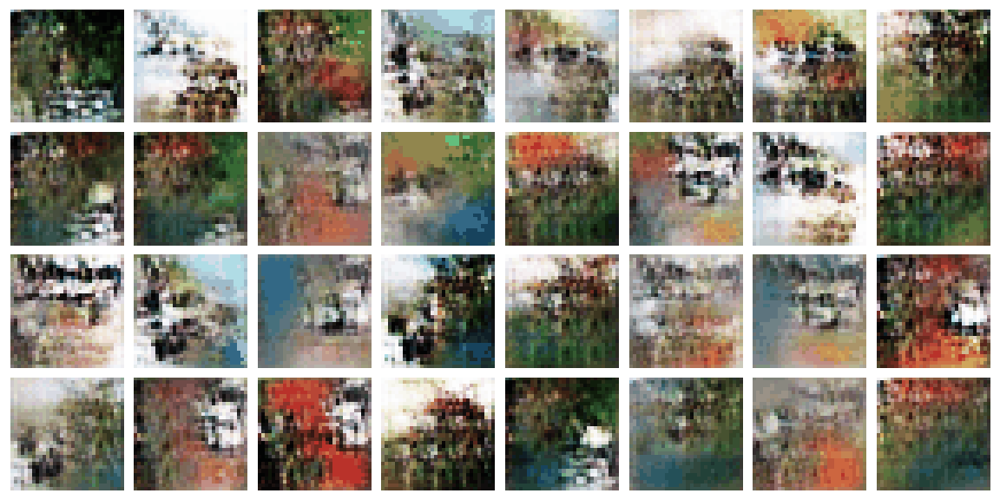

In [72]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

# DCADA GANs
Deep Convolutional Adaptive Discriminator Augmentation GANs or DCADA GANs is my solution for solving the mode collaspe problem I had with the normal DC GANs. I am also using DCADA GANs as the authors of [StyleGAN2-ADA](https://arxiv.org/pdf/2006.06676.pdf) show that discriminator overfitting can be an issue in GANs, especially when only low amounts of training data is available and proposed ADA as a means to mitigate this issue. As I have just witness mode collaspe on my baseline model, this would be a relavent solution to my problem. Coupled with the fact that CIFAR10 is considered a smaller dataset with only 6000 images per class ADA becomes an obvious solution to my problems.

From what I have seen in my baseline model, I have decided to take a different approach in training my GANs. This time, I will be splitting up the dataset into its respective classes. This however means that we only have 6000 images per class (which is bad for GANs but I will solve it by using ADA). The problem with training with the full dataset in my baseline model is that its trying to learn the features of every class and then mash it together. If the discriminator is being trained on how a car, plane and a ship looks like all at once, its going to learn all the features of a car, ship and plane. This will then give the generator feedback on what the combined features of all the classes look like and the final image that is produced will look like an amalgmation of all 10 classes. Therefore, I think that training my GANs on a class by class basis will stop this from happening (which it did) as the discriminator will only learn what a car looks like for example, and thus the feedback it gives the generator during the training process will lead the generator into generating a car that will try fool the discriminator. Therefore, making a better image at the end.

----

## Explaining ADA
Here I will also explain what ADA does. ADA is basically image augmentation, which is a popular technique in deep learning where filters are applied to an image so as to transform them while preserving the general features of it so as to have multiple realistic versions of it, therfore increasing the total amount of training data we have. Its also used to prevent overfitting, thus using it on a discriminator that is overfitted will reduce the possibility of mode collaspe. However, it needs to be done in a smart way so that it only starts applying the augementation to the image only when the discriminator starts overfitting as not doing so might cause imbalance in the adversarial networks where the generator might learn faster than the discriminator or vice versa. Therefore, the image augmentation will be applied using a probability. The probability of the image augmentation being applied is increased based on the discriminators accuracy at interpreting real images. For example, if the discriminator starts interpretting real images with high accuracy and the generator has not yet caught up with producing images to fool the discriminator at the same level of the real images, this will cause a vanishing gradient where the discriminator is too good for the generator to catch up as the discriminator does not provide enough information for the generator to make progress. Therefore, increasing the probability of augmentation when the discriminator starts learning faster than the generator will slow down the discriminators progress on classifying what is real and fake, thus allowing the generator time to catch up to the discriminator and form a balance between the adversarial networks again.

<img src="ada.jpg">

From this graph we can observe that the model with ADA performs better than a model without ADA in low training data situations

----

## Explaining Kernal Inception Distance
I decided to use KID as my main evaluator as since I have split up the dataset by classes for training, we are left with 6000 images per class. Using FID score as an evaluator here is a mistake, as FID is NOT SUITED for small datasets as the number of data inputed to calculate FID score affects its accuracy. From the [Demystifying MMD GANs](https://arxiv.org/pdf/1801.01401.pdf) paper, they compared using FID and KID to evaluate the CIFAR10 dataset. Using Inception Score is also a mistake as its NOT SUITED for the type of evaluation I am trying to do. First, the Inception Score does not capture how generated images compare to the real images. Therefore, in a scenario where I am generating cars trained on the CIFAR10 dataset. Using Inception Score as a metric to see if my generated car images are performing well against the real car images from the dataset is not possible. As the Inception Score only measures image quality and diversity. Therefore, if I score my generated images they are going to score poorly as they are all cars. 

<img src='KID_VS_FID.jpg'>

From this image taken from the paper, you can see that FID score exhibits strong bias for n(which is number of images) even up to 10k samples. While the KID score is less biased and after around 300 samples the standard deviation have shrunk significantly. This is the main reason I would be using KID as my main estimator as I do not have enough data to reduce the bias on the FID score so the FID score will not be accurate. Also since we were tasked to only create only a 1000 new images. Using FID to evaluate them will not be optimal as it will exhibit strong bias and thus not be very accurate.

Much like FID, KID also measures the differences in the generated and training distributions in the representation space of an InceptionV3 network that has been pretrained on the ImageNet dataset. Therefore, we would need to input real and generated images and it will calculate a score for the generated image when it compares it to the real image. A high KID score indicates that the generated images compared to the real images are not good while a low KID score indicates that the generated images compared to the real images are good.

----

## Process Of Training DCADA GANs
As mentioned above, since I am training by classes, I will be running 10 models, one for each class. I will be calculating the KID score of the model per epoch so that I can save the weights of the model when it has the lowest KID score, as that should mean I have saved the weights of the best performing version of the model. At the end of running the model, I will also be saving the model at the last epoch.

I will also be saving the images from the generator every 25 epochs, because I want to make a GIF showing how the images generated as the model is trained on more epochs. To achieve this, I must make it generate on the same input of noise every epoch so I set a constant random uniform noise to input into my generator everytime its time to plot images.

## Functions

### Adaptive Augmenter Function
I have commented out the explaination for how ADA works in the code.

In [21]:
# Acts as a sigmoid activation function
def step(values):
    # returns a number between 0 - 1
    return 0.5 * (1.0 + tf.sign(values))


# This is the function that is incharge of image augmentation for ADA
class AdaptiveAugmenter(keras.Model):
    def __init__(self):
        super().__init__()

        # This is the probability of the image augmentation
        self.probability = tf.Variable(0.0)

        # Theses are the image augmentation that I have chosen based on the what was optimal for low datasets from the paper
        self.augmenter = Sequential(
            [
                layers.InputLayer(input_shape=(image_size, image_size, 3)),
                # image blitting/x-flip
                layers.RandomFlip("horizontal"),
                # image blitting/integer translation
                layers.RandomTranslation(
                    height_factor=max_translation,
                    width_factor=max_translation,
                    interpolation="nearest",
                ),
                # image rotation:
                layers.RandomRotation(factor=max_rotation),
                # isotropic and anisotropic scaling
                layers.RandomZoom(
                    height_factor=(-max_zoom, 0.0), width_factor=(-max_zoom, 0.0)
                ),
            ],
            name="adaptive_augmenter",
        )

    # This function is what the Model calls to augment the images before its parsed into the discriminator
    def call(self, images, training, batch_size):
        if training:
            # Here the images will be sent for augmentation
            augmented_images = self.augmenter(images, training)
            # Then we will select a percentage of augemented images based off the probability variable
            augmentation_values = tf.random.uniform(
                shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
            )
            augmentation_bools = tf.math.less(augmentation_values, self.probability) 
            images = tf.where(augmentation_bools, augmented_images, images)
        return images

    # This function is called every epoch to calculate if we should increase or decrease the augmentation probability based on the discriminator's accuracy to real images.
    def update(self, real_logits):
        current_accuracy = tf.reduce_mean(step(real_logits))
        accuracy_error = current_accuracy - target_accuracy
        self.probability.assign(
            tf.clip_by_value(
                self.probability + accuracy_error / integration_steps, 0.0, 1.0
            )
        )

### Kernel Inception Distance Function

In [22]:
class KID(keras.metrics.Metric):
    def __init__(self, name="kid", **kwargs):
        super().__init__(name=name, **kwargs)

        self.kid_tracker = keras.metrics.Mean()

        self.encoder = keras.Sequential(
            [
                layers.InputLayer(input_shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(tf.keras.applications.inception_v3.preprocess_input),
                tf.keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()

### Discriminator and Generator Functions
This is a DC GANs architechture for my discriminator and generator.
The generator learns to create fake data by incorporating feedback from the discriminator. It learns to make the discriminator classify its output as real.

##### Generator
For my generator,
- It starts with an input layer that takes in one dimensional 64 datapoints of random uniform noise
- I will be using Batch Normalization layers with the learnable scale parameter turned off. Because the ReLU and Conv2DTranspose layers make it redundant. But referencing the [Spectal Normalization For Generative Adversarial Networks](https://arxiv.org/pdf/1802.05957.pdf), there is a theory it should be disabled when using spectral normalization which I didnt use here but is common in GANS.
- For my generator my activation layer is using ReLU. ReLU is recommended to be used on the generator and not the discriminator, and is used to address the vanishing gradient problem. This activation function turns all negative numbers to 0 and does nothing to positive numbers.
- I am also using Conv2DTranspose layers to upsample my image. I will be using a kernel size of 4 and strides of 2 with padding=same. Kernel size of 4 dictates that my 2D convolution window will be a 4x4 shape. A convolution window is what the layer uses to examine the image, with a 4x4 window the layer will be examining the image 4x4 pixels at a time. I set it to 4 as its a way of avoiding the checkboard effect that can happen with upsampling if the kernel size is not double the value of the stride, so if my stride is 2 my kernal size would be 4. With stride of 2, I will be essentially doubling the size of my output which is what I want as I am trying to increase the resolution of my image. And I set padding to same, so that my image will not be downscaled, so that the stride=2 will double the image resolution properly. I set the use bias as false as the batch normalisation in the following layer makes it useless.
- I used a Reshape layer here to Reshape the input data into a 4x4x256 image. We want a high feature map (256) as each of them will have different learnt features that will be collasped in the output layer into a final image. This is done as with more feature maps, the model will be able to pick up on more features to generate and thus produce more detailed images when collasped and outputted.
- I will be outputting a 32x32x3 image from the generator, matching the CIFAR10 dataset image size. I also use the sigmoid activation function here so that all the output values are in the desired range of 0-1

The optimizer I will be using for my generator would be the Adam optimizer with a learning rate of 0.0002 as it has been shown to be the best optimizer to be used on GANs

<img src='dcada_gen.png'>

##### Discriminator
For my discriminator,
- It takes in a 32x32x3 image as its input.
- I tried using a GaussianNoise layer as experiments have suggested that it would help to regularise the discriminator but I chose not to use it as I am already using ADA.
- The Conv2D layers I used have kernel sizes of 4 and strides of 2 with padding=same. This translate to the output after the Conv2D layer would be half. Since I have 2 of these layers in my discriminator, it means that my input data shape would be divided by 2 twice. So the input shape going into the Flatten layer would be 8x8x64. This method is used so that I do not need pooling layers to downsample my images, as I can use the Conv2D layers to achieve a similar effect. My Conv2D layers also have 64 neurons, therefore the feature maps of the images would be increased to 64 layers. This discriminator has the same architecture as a CNN model for good reason. Both architectures are used for Image Classification, in the case for the discriminator it is supposed to classify if the image is real or fake. I set the use_bias=False as the batchnormalization in the following layer makes it useless.
- I used LeakyReLU as my activation layer it has been shown to be the best practice for discriminator models in GANs. Using ReLU in the discriminator might cause the network to be stuck in a popular state called the dying state, using LeakyReLU prevents this as it allows some negative numbers to pass through. The whole idea of GANs will not work if the Generator is unable to learn from the discriminator if the discriminator network is stuck in a dying state situation. Therefore, LeakyReLU is used.
- I used dropout layers on the discriminator as its a means to prevent it from overfitting which will cause problems as I have explained above. The dropout layer basically randomly sets inputs to 0 based on the parameter u set for it. For my discriminator, its set to 0.2, thus it will turn 20% of the inputs to 0.
- The Flatten layer is used to flatten the image shape into one dimension, so from 4x4x256 to 4096
- The output of the model is a dense layer with one neuron. But I will not be applying a activation function, so the output is linear. This is done as its more numerically stable to compute gradients inputting the logits into the loss function later with the from_logits=True statement.

The optimizer I will be using for my discriminator would be the Adam optimizer with a learning rate of 0.0002 as it has been shown to be the best optimizer to be used on GANs

<img src='dcada_discriminator.png'>

In [23]:
# DCGAN generator
def get_generator():
    noise_input = keras.Input(shape=(noise_size,))
    x = layers.Dense(4 * 4 * width, use_bias=False)(noise_input)
    x = layers.BatchNormalization(scale=False)(x)
    x = layers.ReLU()(x)
    x = layers.Reshape(target_shape=(4, 4, width))(x)
    for _ in range(depth - 1):
        x = layers.Conv2DTranspose(
            width, kernel_size=4, strides=2, padding="same", use_bias=False,
        )(x)
        x = layers.BatchNormalization(scale=False)(x)
        x = layers.ReLU()(x)
    image_output = layers.Conv2DTranspose(
        3, kernel_size=4, strides=2, padding="same", activation="sigmoid",
    )(x)

    return keras.Model(noise_input, image_output, name="generator")


# DCGAN discriminator
def get_discriminator():
    image_input = Input(shape=(image_size, image_size, 3))
    x = image_input
    # x = layers.GaussianNoise(0.05,seed=12)(x)
    for _ in range(depth):
        x = layers.Conv2D(
            width, kernel_size=4, strides=2, padding="same", use_bias=False,
        )(x)
        x = layers.BatchNormalization(scale=False)(x)
        x = layers.LeakyReLU(alpha=leaky_relu_slope)(x)
        x = layers.Dropout(0.2)(x)
    x = layers.Flatten()(x)
    x = layers.Dropout(dropout_rate)(x)
    output_score = layers.Dense(1)(x)

    return Model(image_input, output_score, name="discriminator")

### DCADA GANs Model Function
This is the keras subclass model for my DCADA GANs.

The train_step function is the function that is called every epoch
- First, it takes in a batch of real images.
- It runs the real image into the image augmentor, where the ADA process happens (This process has been explained in the Adaptive Augmenter Function above)
- Next, it calls the generator to generate images by inputting random uniform noise.
- It then calculates the KID score using generated and real images (This part has no effect on the training on the GANs model its purely for evaluation)
- We then input the discriminator with a new batch of real images and save the logits from the real images
- Then we input the discriminator with a batch of generated images and save the logits of the generated images (Logits from the discriminator are basically labels from the discriminator classifying if the images are real or fake)
- Next we calculate the adversarial loss, also known as non-saturating GANs loss.
- Then we will update the weights of the model using gradient tape
- Here there is a ema_generator, which tracks the exponential moving average of the normal generator's weights to decrease variance in the generation quality. The images produced from the ema generator have been shown to be better than images produced from the normal generator. Thus I will be saving both the ema and normal generator models so that we can compare them at the end. 
- And every 25 epoch I will save generated images.

In [24]:
class DCADA_GANS(keras.Model):
    def __init__(self, filesavepath):
        super().__init__()

        self.augmenter = AdaptiveAugmenter()
        self.generator = get_generator()
        self.ema_generator = keras.models.clone_model(self.generator)
        self.discriminator = get_discriminator()
        self.fixedLatent = tf.random.normal(shape=(batch_size, noise_size))
        self.filesavepath = filesavepath

        self.generator.summary()
        self.discriminator.summary()

    def compile(self, generator_optimizer, discriminator_optimizer, **kwargs):
        super().compile(**kwargs)

        self.generator_optimizer = generator_optimizer
        self.discriminator_optimizer = discriminator_optimizer

        self.generator_loss_tracker = Mean(name="g_loss")
        self.discriminator_loss_tracker = Mean(name="d_loss")
        self.real_accuracy = BinaryAccuracy(name="real_acc")
        self.generated_accuracy = BinaryAccuracy(name="gen_acc")
        self.augmentation_probability_tracker = Mean(name="aug_p")
        self.kid = KID()

    @property
    def metrics(self):
        return [
            self.generator_loss_tracker,
            self.discriminator_loss_tracker,
            self.real_accuracy,
            self.generated_accuracy,
            self.augmentation_probability_tracker,
            self.kid
        ]

    def generate(self, batch_size, training, latent_ok=True):
        if latent_ok:
            latent_samples = tf.random.normal(shape=(batch_size, noise_size))
        else:
            latent_samples = self.fixedLatent

        if training:
            generated_images = self.generator(latent_samples, training)
        else:
            generated_images = self.ema_generator(latent_samples, training)
        return generated_images

    def adversarial_loss(self, real_logits, generated_logits, batch_size):
        real_labels = tf.ones(shape=(batch_size, 1))
        generated_labels = tf.zeros(shape=(batch_size, 1))

        generator_loss = keras.losses.binary_crossentropy(
            real_labels, generated_logits, from_logits=True
        )
        discriminator_loss = keras.losses.binary_crossentropy(
            tf.concat([real_labels, generated_labels], axis=0),
            tf.concat([real_logits, generated_logits], axis=0),
            from_logits=True,
        )

        return tf.reduce_mean(generator_loss), tf.reduce_mean(discriminator_loss)

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        real_images2 = real_images
        real_images = self.augmenter(real_images, training=True, batch_size=batch_size)

        with tf.GradientTape(persistent=True) as tape:
            generated_images = self.generate(batch_size, training=True)
            self.kid.update_state(real_images2, generated_images)
            generated_images = self.augmenter(generated_images, training=True, batch_size=batch_size)

            real_logits = self.discriminator(real_images, training=True)
            generated_logits = self.discriminator(generated_images, training=True)

            generator_loss, discriminator_loss = self.adversarial_loss(
                real_logits, generated_logits, batch_size=batch_size
            )  

        generator_gradients = tape.gradient(
            generator_loss, self.generator.trainable_weights
        )
        discriminator_gradients = tape.gradient(
            discriminator_loss, self.discriminator.trainable_weights
        )
        self.generator_optimizer.apply_gradients(
            zip(generator_gradients, self.generator.trainable_weights)
        )
        self.discriminator_optimizer.apply_gradients(
            zip(discriminator_gradients, self.discriminator.trainable_weights)
        )
        

        self.augmenter.update(real_logits)
        self.generator_loss_tracker.update_state(generator_loss)
        self.discriminator_loss_tracker.update_state(discriminator_loss)
        self.real_accuracy.update_state(1.0, step(real_logits))
        self.generated_accuracy.update_state(0.0, step(generated_logits))
        self.augmentation_probability_tracker.update_state(self.augmenter.probability)
        
        for weight, ema_weight in zip(
            self.generator.weights, self.ema_generator.weights
        ):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        generated_images = self.generate(batch_size, training=False)

        self.kid.update_state(real_images, generated_images)

        return {self.kid.name: self.kid.result()}

    def plot_images(self, epoch=None, logs=None, num_rows=4, num_cols=8, interval=25):
        if epoch is None or (epoch + 1) % interval == 0:
            num_images = num_rows * num_cols
            generated_images = self.generate(num_images, training=False, latent_ok=False)

            plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
            for row in range(num_rows):
                for col in range(num_cols):
                    index = row * num_cols + col
                    plt.subplot(num_rows, num_cols, index + 1)
                    plt.imshow(generated_images[index])
                    plt.axis("off")
            plt.tight_layout()
            plt.savefig(f'./Generated Images/{self.filesavepath}/epoch{epoch + 1}')
            # plt.show()
            plt.close()

## Models
In this section I will be training the GANs model on a class by class basis. There is nothing here I havent explained above as its just code to run the things I have explained above.

There is code to embed the GIFs I saved of the models training process in each model. I chose to not show the all the outputs as it will cause the notebook to lag, so if you want to see the gifs please run the embed gif cell.

### Airplane

In [23]:
classname = 'airplane'

In [25]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[0],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense_2 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_102 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_3 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

In [26]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/airplanes/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/airplanes/gen\assets


In [27]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [28]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Automobile

In [50]:
classname = 'automobile'

In [31]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[1],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_4 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_202 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_6 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_2 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_7 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 8s 336ms/step - g_loss: 3.1233 - d_loss: 0.2176 - real_acc: 0.8873 - gen_acc: 0.9327 - aug_p: 6.3106e-04 - kid: 1.5838
Epoch 2/3000
24/24 [==============================] - 7s 307ms/step - g_loss: 4.3251 - d_loss: 0.0486 - real_acc: 0.9874 - gen_acc: 0.9971 - aug_p: 0.0035 - kid: 1.7804
Epoch 3/3000
24/24 [==============================] - 7s 305ms/step - g_loss: 4.9393 - d_loss: 0.0384 - real_acc: 0.9886 - gen_acc: 0.9953 - aug_p: 0.0068 - kid: 1.6575
Epoch 4/3000
24/24 [==============================] - 8s 322ms/step - g_loss: 6.1089 - d_loss: 0.2778 - real_acc: 0.9008 - gen_acc: 0.9046 - aug_p: 0.0091 - kid: 1.3426
Epoch 5/3000
24/24 [==============================] - 8s 315ms/step - g_loss: 3.8200 - d_loss: 0.1991 - real_acc: 0.9063 - gen_acc: 0.9350 - aug_p: 0.0106 - kid: 1.7926
Epoch 6/3000
24/24 [==============================] - 8s 323ms/step - g_loss: 3.9661 - d_loss: 0.1871 - real_acc: 0.9303 - gen_acc: 0.9349 - aug_p: 0.0

In [32]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/automobiles/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/automobiles/gen\assets


In [33]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [51]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Bird

In [18]:
classname = 'bird'

In [35]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[2],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_6 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_302 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_9 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_3 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_10 (Conv2D  (None, 8, 8, 256)        1048576   
 Transpose)                                              

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 8s 341ms/step - g_loss: 4.0349 - d_loss: 0.2757 - real_acc: 0.8828 - gen_acc: 0.8743 - aug_p: 8.1217e-04 - kid: 1.8581
Epoch 2/3000
24/24 [==============================] - 8s 315ms/step - g_loss: 4.0520 - d_loss: 0.0544 - real_acc: 0.9899 - gen_acc: 0.9973 - aug_p: 0.0038 - kid: 1.8936
Epoch 3/3000
24/24 [==============================] - 8s 327ms/step - g_loss: 4.1524 - d_loss: 0.2719 - real_acc: 0.8947 - gen_acc: 0.8991 - aug_p: 0.0063 - kid: 1.6699
Epoch 4/3000
24/24 [==============================] - 8s 330ms/step - g_loss: 2.4859 - d_loss: 0.3884 - real_acc: 0.8194 - gen_acc: 0.8294 - aug_p: 0.0060 - kid: 1.4796
Epoch 5/3000
24/24 [==============================] - 8s 330ms/step - g_loss: 3.0798 - d_loss: 0.2633 - real_acc: 0.8872 - gen_acc: 0.8907 - aug_p: 0.0062 - kid: 1.3961
Epoch 6/3000
24/24 [==============================] - 8s 313ms/step - g_loss: 3.4744 - d_loss: 0.1298 - real_acc: 0.9511 - gen_acc: 0.9661 - aug_p: 0.0

In [36]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/bird/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/bird/gen\assets


In [37]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [19]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Cat

In [21]:
classname = 'cat'

In [41]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[3],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_32 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_12 (Dense)            (None, 4096)              262144    
                                                                 
 batch_normalization_602 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_18 (ReLU)             (None, 4096)              0         
                                                                 
 reshape_6 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_19 (Conv2D  (None, 8, 8, 256)        1048576   
 Transpose)                                              

In [42]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/cat/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/cat/gen\assets


In [43]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [25]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Deer

In [27]:
classname = 'deer'

In [45]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[4],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_37 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_14 (Dense)            (None, 4096)              262144    
                                                                 
 batch_normalization_702 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_21 (ReLU)             (None, 4096)              0         
                                                                 
 reshape_7 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_22 (Conv2D  (None, 8, 8, 256)        1048576   
 Transpose)                                              

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 10s 398ms/step - g_loss: 2.7207 - d_loss: 0.2712 - real_acc: 0.8655 - gen_acc: 0.9082 - aug_p: 5.9640e-04 - kid: 1.5712
Epoch 2/3000
24/24 [==============================] - 7s 312ms/step - g_loss: 4.3733 - d_loss: 0.0418 - real_acc: 0.9940 - gen_acc: 0.9992 - aug_p: 0.0036 - kid: 1.5802
Epoch 3/3000
24/24 [==============================] - 8s 333ms/step - g_loss: 4.9136 - d_loss: 0.1878 - real_acc: 0.9318 - gen_acc: 0.9307 - aug_p: 0.0067 - kid: 1.1236
Epoch 4/3000
24/24 [==============================] - 8s 330ms/step - g_loss: 3.3622 - d_loss: 0.4231 - real_acc: 0.8316 - gen_acc: 0.8148 - aug_p: 0.0071 - kid: 0.9428
Epoch 5/3000
24/24 [==============================] - 8s 334ms/step - g_loss: 3.1255 - d_loss: 0.2479 - real_acc: 0.9005 - gen_acc: 0.9094 - aug_p: 0.0075 - kid: 0.6245
Epoch 6/3000
24/24 [==============================] - 8s 322ms/step - g_loss: 3.2492 - d_loss: 0.1728 - real_acc: 0.9297 - gen_acc: 0.9416 - aug_p: 0.

In [46]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/deer/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/deer/gen\assets


In [ ]:
plot_accuracy_and_loss(history)

In [29]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Dog

In [32]:
classname = 'dog'

In [24]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[5],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense (Dense)               (None, 4096)              262144    
                                                                 
 batch_normalization_2 (Batc  (None, 4096)             12288     
 hNormalization)                                                 
                                                                 
 re_lu (ReLU)                (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 9s 337ms/step - g_loss: 4.4146 - d_loss: 0.3190 - real_acc: 0.8769 - gen_acc: 0.8301 - aug_p: 6.8010e-04 - kid: 4.0360
Epoch 2/3000
24/24 [==============================] - 8s 324ms/step - g_loss: 4.7372 - d_loss: 0.0648 - real_acc: 0.9860 - gen_acc: 0.9921 - aug_p: 0.0034 - kid: 4.5323
Epoch 3/3000
24/24 [==============================] - 7s 311ms/step - g_loss: 6.3180 - d_loss: 0.1961 - real_acc: 0.9271 - gen_acc: 0.9306 - aug_p: 0.0063 - kid: 4.5311
Epoch 4/3000
24/24 [==============================] - 7s 306ms/step - g_loss: 3.3661 - d_loss: 0.1586 - real_acc: 0.9393 - gen_acc: 0.9609 - aug_p: 0.0081 - kid: 4.1570
Epoch 5/3000
24/24 [==============================] - 8s 329ms/step - g_loss: 2.3648 - d_loss: 0.4283 - real_acc: 0.8085 - gen_acc: 0.7995 - aug_p: 0.0084 - kid: 3.8951
Epoch 6/3000
24/24 [==============================] - 8s 312ms/step - g_loss: 2.8129 - d_loss: 0.2519 - real_acc: 0.8981 - gen_acc: 0.8946 - aug_p: 0.0

In [25]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/dog/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/dog/gen\assets


In [26]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [33]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Frog

In [36]:
classname = 'frog'

In [28]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[6],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense_2 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_102 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_3 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 9s 363ms/step - g_loss: 3.3358 - d_loss: 0.1950 - real_acc: 0.8978 - gen_acc: 0.9510 - aug_p: 9.2057e-04 - kid: 1.2346
Epoch 2/3000
24/24 [==============================] - 9s 397ms/step - g_loss: 6.5610 - d_loss: 0.0437 - real_acc: 0.9906 - gen_acc: 0.9913 - aug_p: 0.0041 - kid: 1.0717
Epoch 3/3000
24/24 [==============================] - 10s 424ms/step - g_loss: 5.3829 - d_loss: 0.0454 - real_acc: 0.9878 - gen_acc: 0.9924 - aug_p: 0.0074 - kid: 1.3363
Epoch 4/3000
24/24 [==============================] - 9s 366ms/step - g_loss: 5.6169 - d_loss: 0.3002 - real_acc: 0.8914 - gen_acc: 0.8817 - aug_p: 0.0097 - kid: 0.7139
Epoch 5/3000
24/24 [==============================] - 10s 406ms/step - g_loss: 3.5875 - d_loss: 0.3117 - real_acc: 0.8638 - gen_acc: 0.8471 - aug_p: 0.0099 - kid: 0.7608
Epoch 6/3000
24/24 [==============================] - 9s 364ms/step - g_loss: 3.7514 - d_loss: 0.1864 - real_acc: 0.9272 - gen_acc: 0.9287 - aug_p: 0

In [29]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/frog/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/frog/gen\assets


In [30]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [37]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Horse

In [40]:
classname = 'horse'

In [33]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[7],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 64)]              0         
                                                                 
 dense_6 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_302 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_9 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_3 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_10 (Conv2D  (None, 8, 8, 256)        1048576   
 Transpose)                                              

In [34]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/horse/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/horse/gen\assets


In [35]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [41]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Ship

In [43]:
classname = 'ship'

In [24]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[8],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense (Dense)               (None, 4096)              262144    
                                                                 
 batch_normalization_2 (Batc  (None, 4096)             12288     
 hNormalization)                                                 
                                                                 
 re_lu (ReLU)                (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 10s 358ms/step - g_loss: 3.0731 - d_loss: 0.2137 - real_acc: 0.8925 - gen_acc: 0.9338 - aug_p: 6.1247e-04 - kid: 1.2929
Epoch 2/3000
24/24 [==============================] - 8s 332ms/step - g_loss: 4.4165 - d_loss: 0.0429 - real_acc: 0.9886 - gen_acc: 0.9980 - aug_p: 0.0035 - kid: 1.5260
Epoch 3/3000
24/24 [==============================] - 8s 346ms/step - g_loss: 8.1297 - d_loss: 0.2581 - real_acc: 0.9120 - gen_acc: 0.9074 - aug_p: 0.0059 - kid: 1.2585
Epoch 4/3000
24/24 [==============================] - 8s 341ms/step - g_loss: 2.8667 - d_loss: 0.4012 - real_acc: 0.8406 - gen_acc: 0.8244 - aug_p: 0.0064 - kid: 0.9426
Epoch 5/3000
24/24 [==============================] - 8s 322ms/step - g_loss: 2.9630 - d_loss: 0.2272 - real_acc: 0.8982 - gen_acc: 0.9251 - aug_p: 0.0068 - kid: 1.2360
Epoch 6/3000
24/24 [==============================] - 8s 322ms/step - g_loss: 3.5028 - d_loss: 0.1257 - real_acc: 0.9435 - gen_acc: 0.9775 - aug_p: 0.

In [25]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/ship/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/ship/gen\assets


In [26]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [44]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

### Truck

In [47]:
classname = 'truck'

In [28]:
# Compling model
model = DCADA_GANS(classname)
model.compile(
    generator_optimizer=Adam(learning_rate, beta_1),
    discriminator_optimizer=Adam(learning_rate, beta_1),
)

# Saving Best Model Based off KID
checkpoint_path = f"./Model History/{classname}/DCADA_GAN_{classname}"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
    save_weights_only=True,
    monitor="kid",
    mode="min",
    save_best_only=True,
)

# Train Model
history = model.fit(
    split_dataset[9],
    epochs=num_epochs,
    batch_size=batch_size,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

# Saving Model History
with open(f'Model History/dcada_{classname.lower()}_history', 'wb') as file_pi:
    pickle.dump(history.history, file_pi)

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense_2 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_102 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_3 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                                               

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Epoch 1/3000
24/24 [==============================] - 10s 398ms/step - g_loss: 3.4753 - d_loss: 0.1795 - real_acc: 0.9026 - gen_acc: 0.9561 - aug_p: 7.7896e-04 - kid: 1.2434
Epoch 2/3000
24/24 [==============================] - 8s 338ms/step - g_loss: 8.4812 - d_loss: 0.2077 - real_acc: 0.9305 - gen_acc: 0.8881 - aug_p: 0.0030 - kid: 1.2760
Epoch 3/3000
24/24 [==============================] - 9s 357ms/step - g_loss: 3.5898 - d_loss: 0.3523 - real_acc: 0.8593 - gen_acc: 0.8585 - aug_p: 0.0044 - kid: 1.0602
Epoch 4/3000
24/24 [==============================] - 8s 334ms/step - g_loss: 2.2823 - d_loss: 0.3391 - real_acc: 0.8426 - gen_acc: 0.8854 - aug_p: 0.0040 - kid: 1.1181
Epoch 5/3000
24/24 [==============================] - 18s 766ms/step - g_loss: 2.6695 - d_loss: 0.1991 - real_acc: 0.9153 - gen_acc: 0.9532 - aug_p: 0.0048 - kid: 1.9653
Epoch 6/3000
24/24 [==============================] - 8s 317ms/step - g_loss: 3.1951 - d_loss: 0.1303 - real_acc: 0.9507 - gen_acc: 0.9748 - aug_p: 0

In [29]:
# Saving normal generator and ema_generator
saveModels(model,classname)

INFO:tensorflow:Assets written to: ./Model History/truck/emaGen\assets
INFO:tensorflow:Assets written to: ./Model History/truck/gen\assets


In [30]:
plot_accuracy_and_loss(history)

C:\Users\Andric\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [48]:
loadGIFS(classname)

In [ ]:
embed_file(f'./Generated Images/{classname}/{classname}.gif')

## Model Evaluation
I will be evaluating the output of the models using visuals, KID score and FID score. I will then choose the final images from this evaluation.

### Functions

#### Get Predictions

In [25]:
def get_predictions(model_names, num_images=1000, kid_model=None, save_images=True):
    original_images = []
    fid_scores = []
    generated_images = []
    saved_images = []
    for i in range(10):
        # current_class = list(cifar10_labels.values())[i]
        current_class = class_names[i]
        random_idx = np.random.choice(split_dataset[i].shape[0],num_images,False)
        original_images.append(split_dataset[i][random_idx])
        # original_images.append(dataset_list[current_class][:num_images])
        print(f'Models/{current_class}/{model_names[i]}')

        latent_samples = tf.random.normal(shape=(num_images, 64))
        if kid_model != None:
            model = kid_model('testing')
            model.built = True
            model.compile(
                generator_optimizer= Adam(learning_rate, beta_1),
                discriminator_optimizer= Adam(learning_rate, beta_1),
            )
            model.load_weights(f'./Model History/{current_class}/bestKID/').expect_partial()
            model = model.ema_generator
        else: 
            model = load_model(f'./Model History/{current_class}/{model_names[i]}')

        pred = model.predict(latent_samples)
        saved_images += list(pred)
        generated_images.append(pred)

        # if save_images:
        #     for j in range(num_images):
        #         imageio.imwrite(f'Final Images/{current_class}img{j+1}.png', pred[j])

        # fid_score = calculate_fid(dataset_list[current_class][:num_images], pred)
        # fid_scores.append(fid_score)

    # original_images = np.array(original_images).reshape(num_images*10,32,32,3)
    return original_images, np.array(generated_images)

#### Frechet Inception Distance

In [26]:
def scale_images(images, new_shape):
    images_list = list()
    for image in images:
        new_image = resize(image, new_shape, 0)
        images_list.append(new_image)
    return np.asarray(images_list)

def selectPerLabel():
    imgArray = []
    for i in range(10):
        idx = (y_train == i).reshape(X_train.shape[0])
        imgArray.append(X_train[idx][:100])
    return np.array(imgArray).reshape(1000, 32, 32, 3)

def calculate_fid(real_img, generated_img):
    real_img = scale_images(real_img, (299, 299, 3))
    generated_img = scale_images(generated_img, (299, 299, 3))

    real_img = real_img * 255
    generated_img = generated_img * 255

    real_img = preprocess_input(real_img)
    generated_img = preprocess_input(generated_img)

    model = InceptionV3(include_top=False, pooling='avg',
                        input_shape=(299, 299, 3))

    act1 = model.predict(real_img)
    act2 = model.predict(generated_img)

    mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)

    ssdiff = np.sum((mu1 - mu2)**2.0)

    covmean = sqrtm(sigma1.dot(sigma2))

    if iscomplexobj(covmean):
        covmean = covmean.real

    fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

train_first100 = selectPerLabel()

### Evaluation
I will be carrying out my evaluation in 3 steps.
1. Visual Evaluation
2. Kernel Inception Distance
3. Frechet Inception Distance

I will then choose the 1000 images that I think are the best from evaluation.

#### Loading Evaluation Data
I will be loading the best kid model for each class, as after some experimentation with using the emaGenerator and the normal Generator saved at the end of the model. I found that the best kid model is the best. After loading the models, I will be using the generator to generate 1000 images per class for evaluation.

In [27]:
original, predicted = get_predictions(class_names, kid_model=DCADA_GANS)

Models/airplane/airplane
Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense (Dense)               (None, 4096)              262144    
                                                                 
 batch_normalization_2 (Batc  (None, 4096)             12288     
 hNormalization)                                                 
                                                                 
 re_lu (ReLU)                (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                      

C:\Users\Andric\anaconda3\lib\site-packages\tensorflow\python\data\ops\dataset_ops.py:4526: UserWarning:

Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.



Models/automobile/automobile
Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 64)]              0         
                                                                 
 dense_2 (Dense)             (None, 4096)              262144    
                                                                 
 batch_normalization_102 (Ba  (None, 4096)             12288     
 tchNormalization)                                               
                                                                 
 re_lu_3 (ReLU)              (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 8, 8, 256)        1048576   
 ranspose)                  

#### Visual Evaluation
For visual evaluation, I will be using my eyes and scoring the classes from a humans perspective.

- airplane      6/10						
- automobile    9/10							
- bird			7/10							
- cat			4/10							
- deer			6/10							
- dog			4/10							
- frog			5/10							
- horse			8/10							
- ship			7/10							
- truck         8/10

**In the next cell I will be explaining in detail how I scored the classes.**

##### Detailed Explaination for each class

- For the Airplane images, they are barely distinguishable as airplanes. As only in some images you can see a good looking plane. However, you are able to make out the wings of the plane in most of the images. Thus I will rate it a 6/10 for visuals

- For the Car image, I think they are the best looking class. Most of the images are easily distinguishable and they look pretty detailed as you can see the headlights, grill, wheel rims, windshield and windows quite clearly. Thus I will rate it a 9/10 for visuals

- For the Bird images, some of the generated bird images lack detail, for example there is the shape of the birds body but the model did not draw out the legs and tail of the bird. However there are also some bird pictures that are pretty well generated where you can see the beak, legs and even tail feather of the bird. Thus I will rate it a 7/10 for visuals

- Many of the cat images are pretty bad as its hard to make out an image of a cat in the generated image. This might be due to the discriminator not performing well when training the GANs using the Cat images. From my past experience working with the CIFAR10 dataset, I have found that cat and dog images are pretty hard for a CNN model which is what the discriminator is to classify properly. Thus the discriminator might be classifying badly when training on Cat images and due to that will give bad feedback to the generator on how to generate cat images. Thats why the images generated are poor. This might also be due to the fact that the cat images in the original CIFAR10 dataset are not the best anyways, so that might have added on to the issue. I rate it a 4/10 for visuals.

- The Deer image quality is quite similar to the airplane's. As some of the images you can clearly see a deer. But for most images, they are barely distinguishable as they are mostly lacking details showing their legs. This might be due to the fact that deer legs are quite thin in the original CIFAR10 images and thus the model might have a hard time trying to learn those features. Thus I will rate it a 6/10 for visuals.

- The Dog images suffer from the same problem as the cat images. They have similar quality where its pretty difficult to make out an image of a dog in the generated images. As I mentioned just now with the cats. This might be due to the discriminator not performing well and also the original CIFAR10 image quality are not the best. I will rate this a 4/10 for visuals.

- The Frog images have alot of variance in quality. While some of them just look like noise, there are also images of frogs where its easily distinguishable. I suspect the reason for such a variance in quality is due to the CIFAR10 images as the images for frogs are really blurry for some of them. This is probably what causes the noise as the discriminator struggles to figure out the features of the frog as its blurry and it starts to produce noise. I rate this a 5/10 for visuals

- The horse images are one of the better looking classes. It is easily distinguishable that its a horse and it the images are quite high quality. With them showing all 4 legs of the horse, the tail, the different pattern coats of the horse. I will rate this a 8/10 for visuals

- The ship images are also one of the better looking classes. In most of the images, we can see the silhouette of a boat on water. There is also a good amount of detail on the boat. The class is quite distinguishable, but there are some poor images where there is no ships in the image. I will rate this a 7/10 for visuals

- Finally the truck class. This class is also one of the better looking classes. In most of the images its easily distinguishable to be a truck. There is also a good amount of detail on the trucks where you can see their windscreen very clearly, their wheels, headlights and doors. I will rate this a 8/10 for visuals.

After visual evaluation of all the classes, I can see that there is no evidence of mode collaspe from the images, which means implementing ADA has worked.

airplane


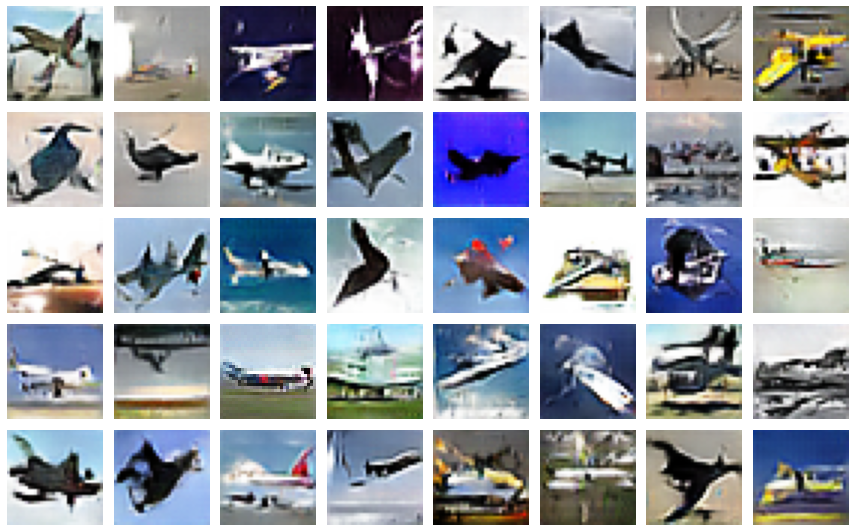

automobile


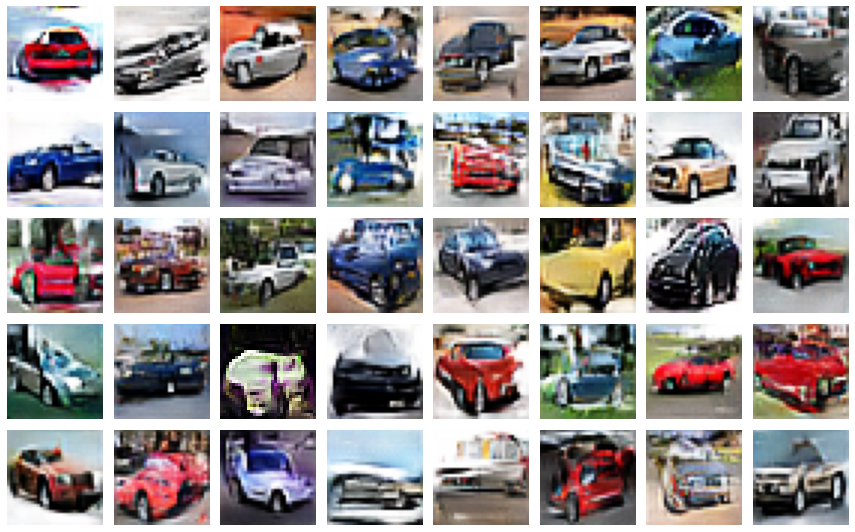

bird


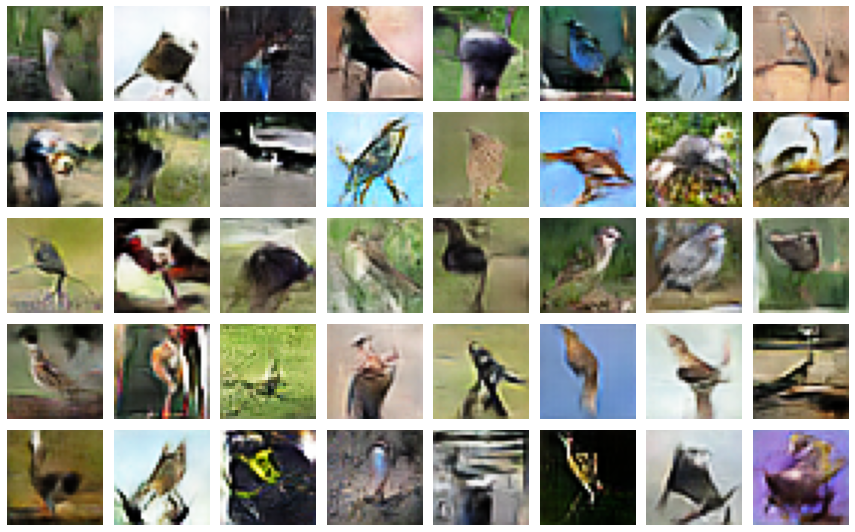

cat


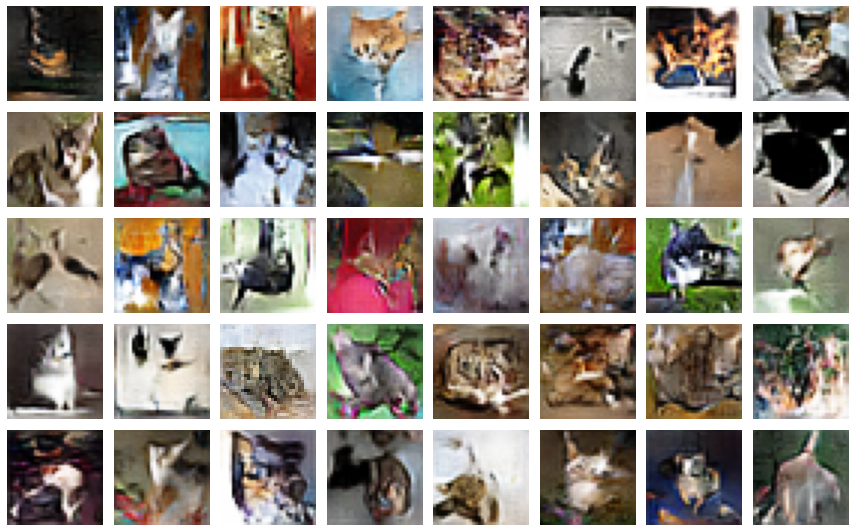

deer


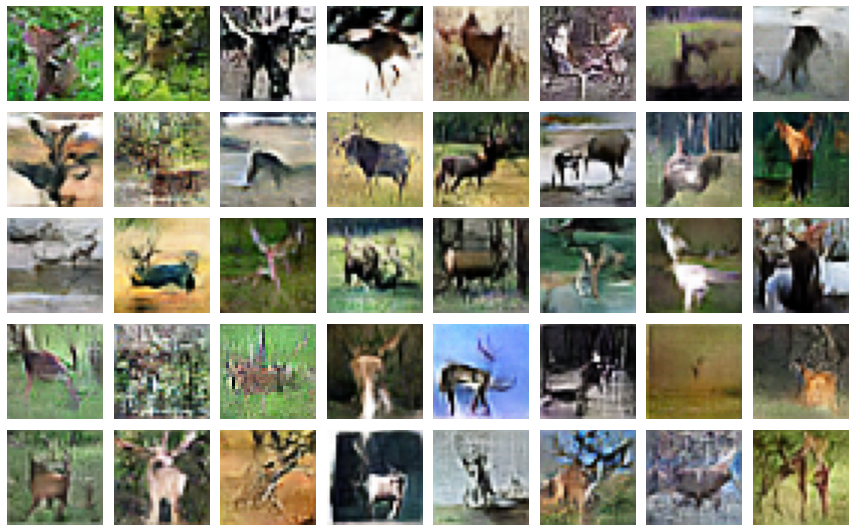

dog


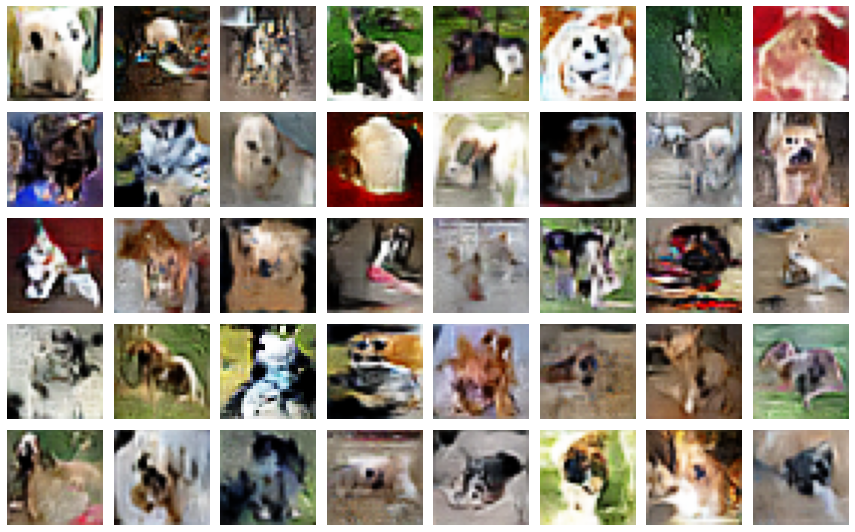

frog


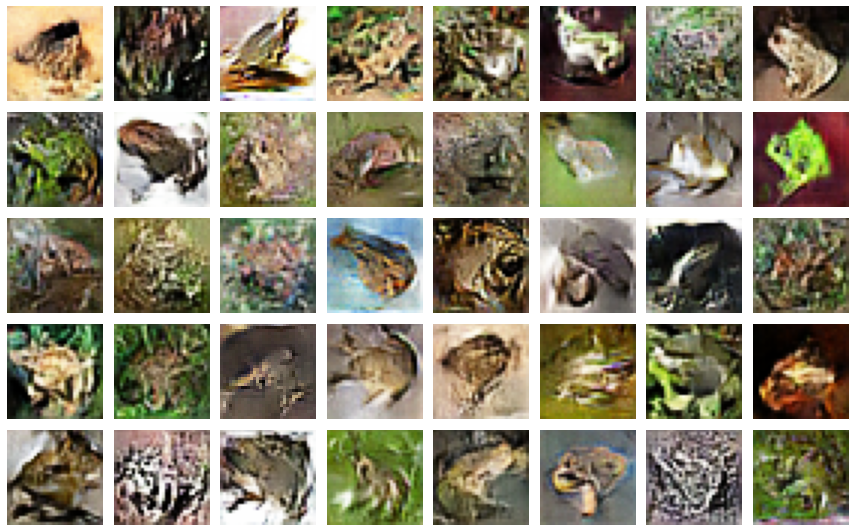

horse


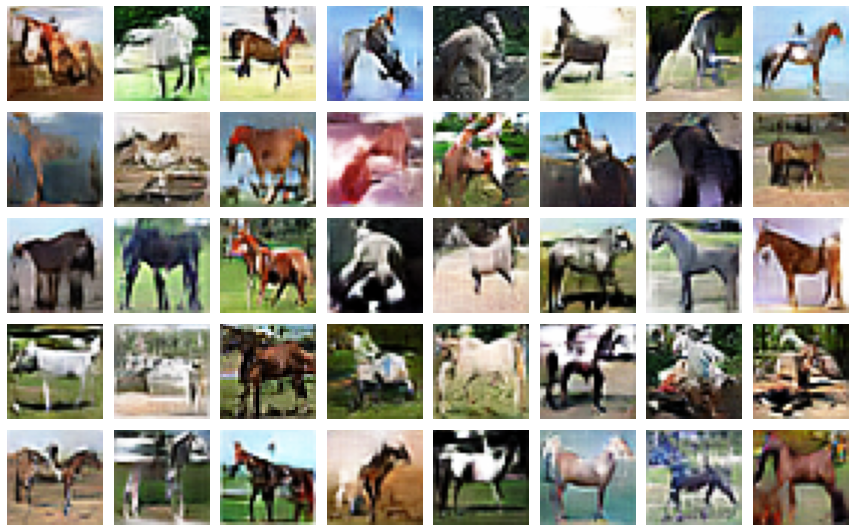

ship


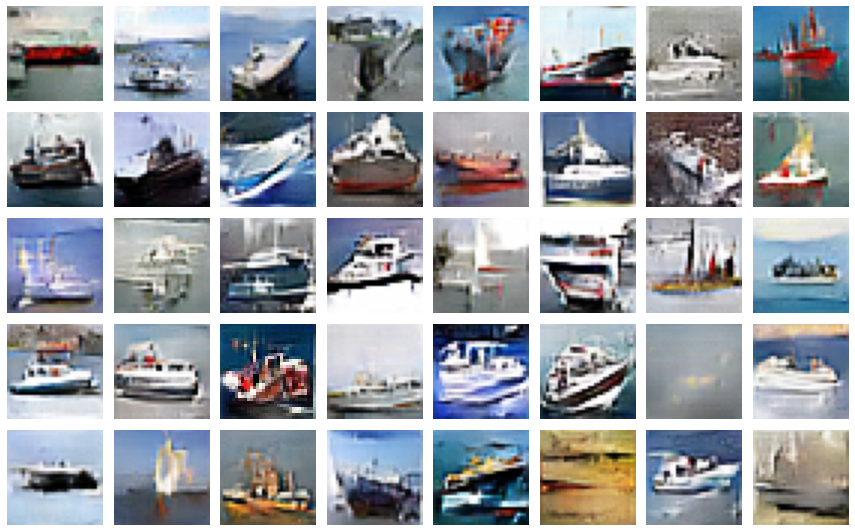

truck


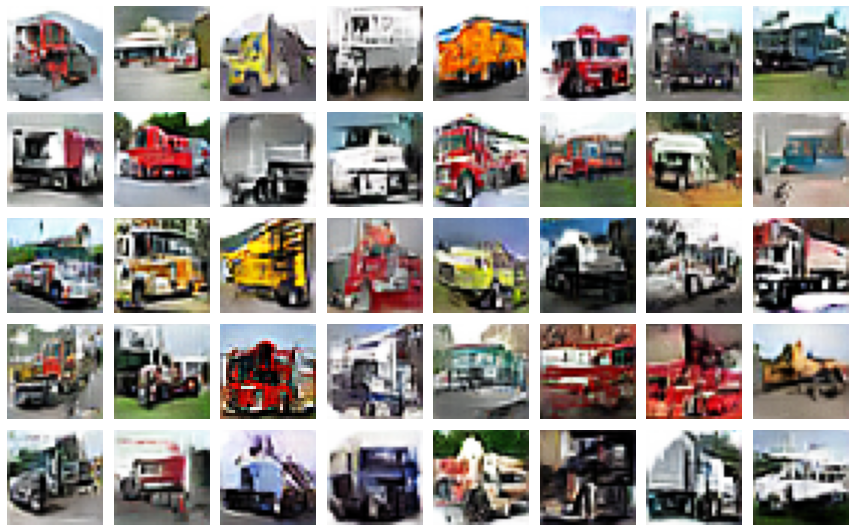

In [48]:
for i in range(10):
    plt.figure(figsize=(8*1.5, 5*1.5))
    for row in range(5):
        for col in range(8):
            index = row * 8 + col
            plt.subplot(5, 8, index + 1)
            plt.imshow(predicted[i][index])
            plt.axis("off")
    print(class_names[i])
    plt.tight_layout()
    plt.show()
    plt.close()

#### Kernel Inception Distance Evaluation
I will now be using the KID score as a metric to evaluate the generated images. The reasoning why I decided to use KID as my scoring metric has been explained previously [here](#explaining-kernal-inception-distance) before I started on my final model. The key takeaways are that using FID scoring is a mistake as it is biased until you can provide it with sufficient data(around 10k). And KID does not suffer from that bias, and since we are working on a smaller dataset its better to use KID as the scoring metric. A high KID score indicates that the generated images compared to the real images are not good while a low KID score indicates that the generated images compared to the real images are good.

If we rank the classes based on who as the best KID score it would be
1. frog
2. truck
3. ship
4. automobile
5. airplane
6. deer
7. horse
8. bird
9. cat
10. dog

In [28]:
kidModel = KID()
for i in range(10):
    kidModel.reset_state()
    kidModel.update_state(original[i], predicted[i])
    print(f'{class_names[i]} KID score: {kidModel.result()}')

airplane KID score: 0.04941701889038086
automobile KID score: 0.037325382232666016
bird KID score: 0.28060007095336914
cat KID score: 0.2972273826599121
deer KID score: 0.08402800559997559
dog KID score: 1.3563957214355469
frog KID score: 0.023260116577148438
horse KID score: 0.21228599548339844
ship KID score: 0.03696465492248535
truck KID score: 0.03260970115661621


#### Frechet Inception Distance Evaluation
Although there is a bias in using FID as a metric of evaluation, I still calculate the score but will have to take it with a grain of salt as this score is probably not accurate due to the bias. However, since all my classes have the same amount of data that is used to calculate the FID score, they should all have the same bias, thus it should be ok to use the score to compare classes to classes.

The Frechet Inception Distance is a metric that calculates the distance between feature vectors calculated for real and generated images. Therefore, a high FID score indicates that the generated image compared to the real image is bad. While a low FID score indicates that the generated image compared to the real image is good.

Here is the classes ranked based on the best FID score.

1. truck
2. ship
3. automobile
4. deer
5. horse
6. airplane
7. frog
8. bird
9. cat
10. dog

In [29]:
for i in range(10):
    fidScore = calculate_fid(original[i], predicted[i])
    print(f'{class_names[i]} FID Score : {fidScore}')


airplane FID Score : 69.57974060593403
automobile FID Score : 44.93187856965871
bird FID Score : 80.75149327032892
cat FID Score : 81.24381757566684
deer FID Score : 59.4492442111945
dog FID Score : 90.68729333604497
frog FID Score : 70.93056492606019
horse FID Score : 62.934029573612186
ship FID Score : 44.165771414152935
truck FID Score : 41.58044024429171


# Choosing 1000 Final Images
Here I will be choosing which 1000 images I would like to use for my final Images. I will not use all 10 classes as there are some classes producing poor images.

Based off my evaluation, I would be using the Automobile, Horse, Truck and Ship classes. I chose these classes after taking in account how the classes look visually, how they scored on the KID metric and finally how they scored on the FID metric.

Since I chose 4 classes, I will have 250 generated images for each class and I will save them to the "Final Images" folder.

In [42]:
finalAutomobile = predicted[1][:250]
finalHorse = predicted[7][:250]
finalShip = predicted[8][:250]
finalTruck = predicted[9][:250]
print(finalAutomobile.shape)
print(finalHorse.shape)
print(finalShip.shape)
print(finalTruck.shape)

(250, 32, 32, 3)
(250, 32, 32, 3)
(250, 32, 32, 3)
(250, 32, 32, 3)


In [ ]:
final_classes = ['automobile', 'horse', 'ship', 'truck']
final_data = [finalAutomobile, finalHorse, finalShip, finalTruck]
count = 0
for current_class in final_classes:
    for j in range(250):
        imageio.imwrite(f'Final Images/{current_class}img{j+1}.png', final_data[count][j])
    count += 1

# Conclusion
In conclusion, I have successfully generated 1000 good quality images from the CIFAR10 Dataset using GANS. I also used an Auto Encoder with SSIM Metric to clean up the dataset before training the GANs as I found out that GANs are sensitive to bad image inputs. I have explored the GANs architecture in great detail and implemented a working DC GANs model that uses ADA to fix the shortcomings of the CIFAR10 dataset where there is too little data. I fixed the mode collaspe of the baseline model techniques such as ADA and also produced better images by splitting up the training of GANs by the classes in CIFAR10. I have also explored different types of evaluation metrics and the shortcoming of some of them to score my GANs so that I can compare them with each other.

# References
- https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-an-mnist-handwritten-digits-from-scratch-in-keras/
- https://machinelearningmastery.com/how-to-code-generative-adversarial-network-hacks/
- https://arxiv.org/pdf/1406.2661.pdf
- https://arxiv.org/pdf/1801.01401.pdf
- https://arxiv.org/pdf/2006.06676.pdf
- https://arxiv.org/pdf/1801.01973.pdf
- https://arxiv.org/pdf/1802.05957.pdf
- https://keras.io/api/layers/regularization_layers/dropout/#:~:text=The%20Dropout%20layer%20randomly%20sets,time%2C%20which%20helps%20prevent%20overfitting.&text=Note%20that%20the%20Dropout%20layer,When%20using%20model